# Resized Image Testing

351 534 3
points used:  121 exceptions  0
351 534 3
points used:  121 exceptions  0
351 534 3
points used:  121 exceptions  0
0
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  441 exceptions  0
225 300 3
points used:  231 exceptions  0
1
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
2
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
3
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
225 300 3
points used:  231 exceptions  0
4
2219 3324 3
points used:  121 exceptions  0
2219 3324 3
points used:  121 exceptions  0
2219 3324 3
points used:  121 exceptions  0
5
768 1024 3
points used:  231 exceptions  0
768 1024 3
points used:  231 exceptions  0
768 1024 3
points used:  231 exceptions  0
6


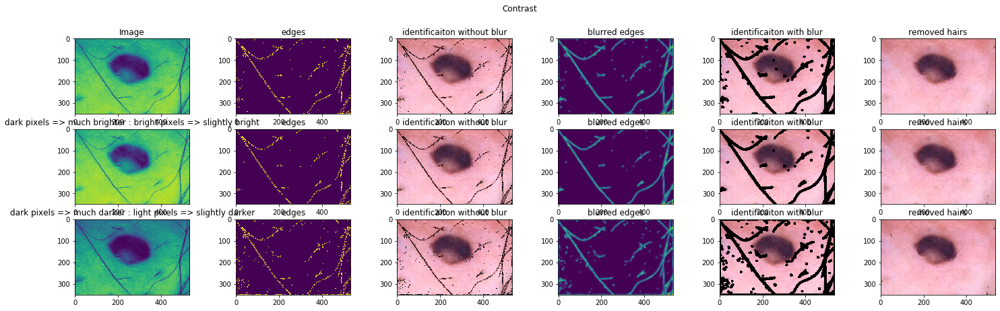

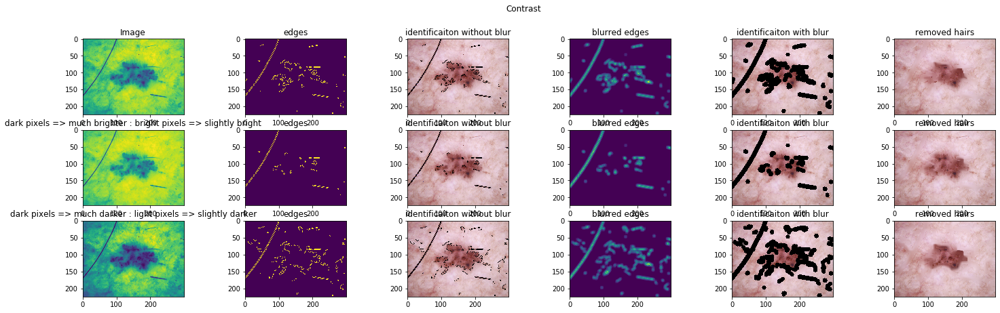

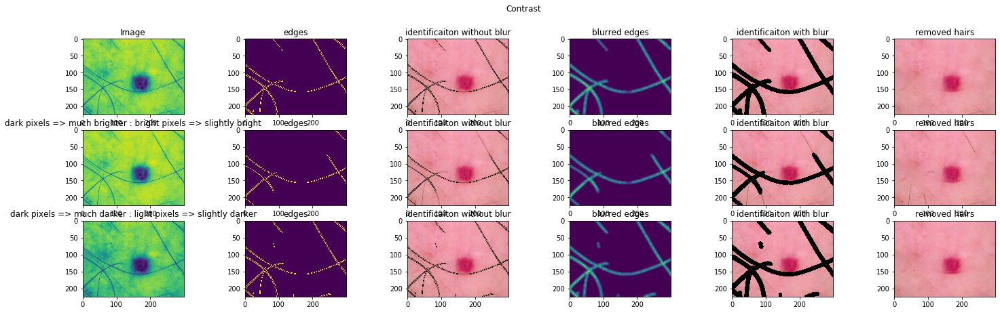

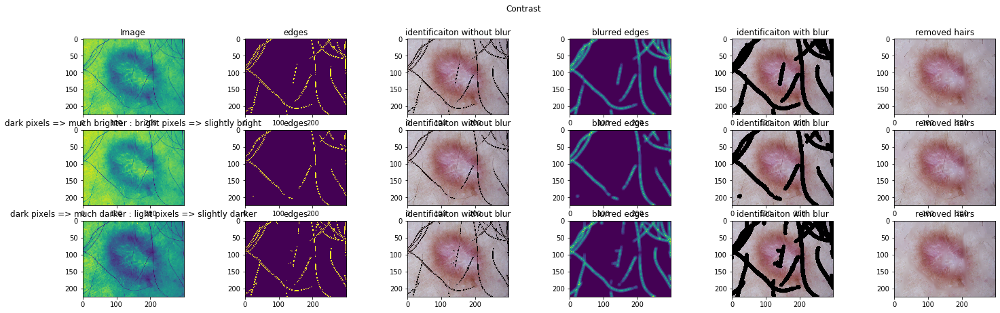

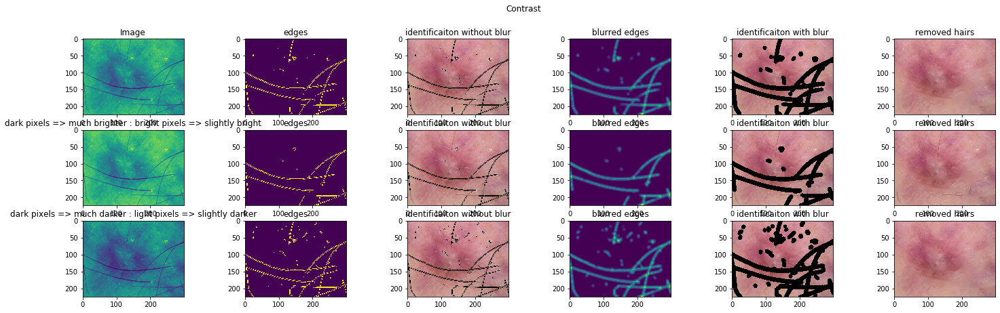

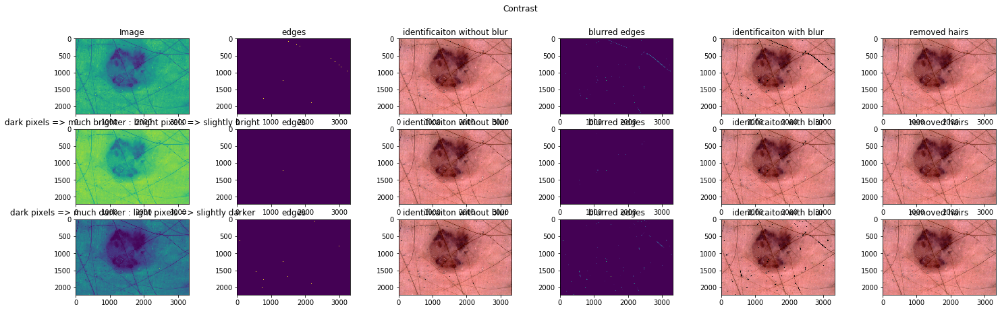

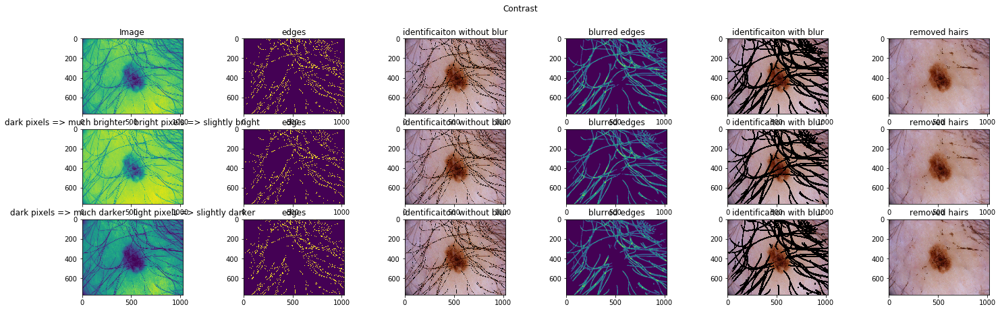

In [50]:
for i in range(7):
    showContrastWithBluredEdgeDetection2(i)
    print("Image", i)

225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3


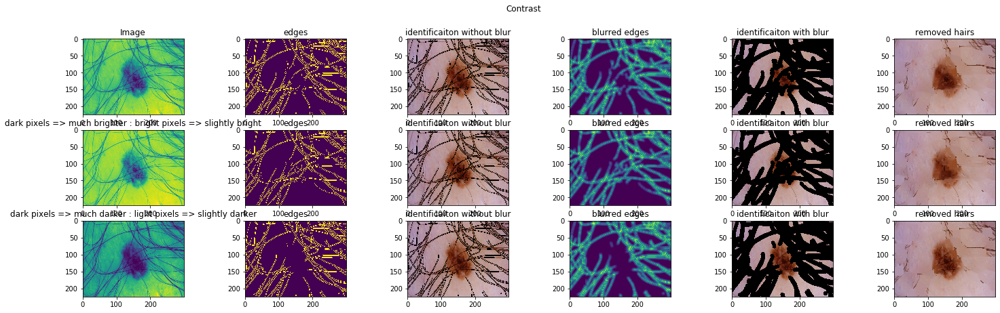

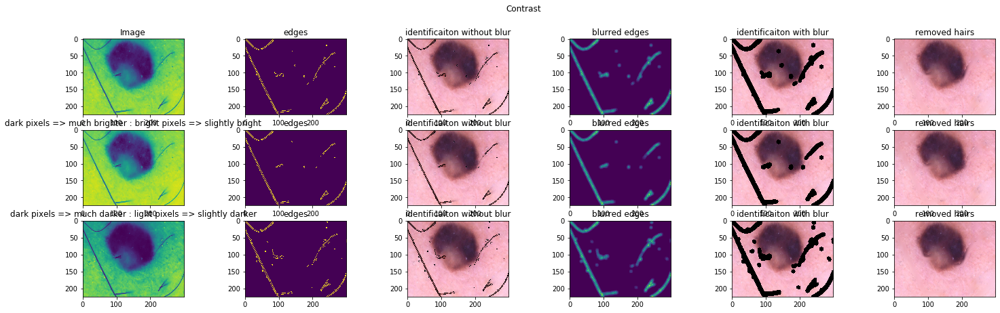

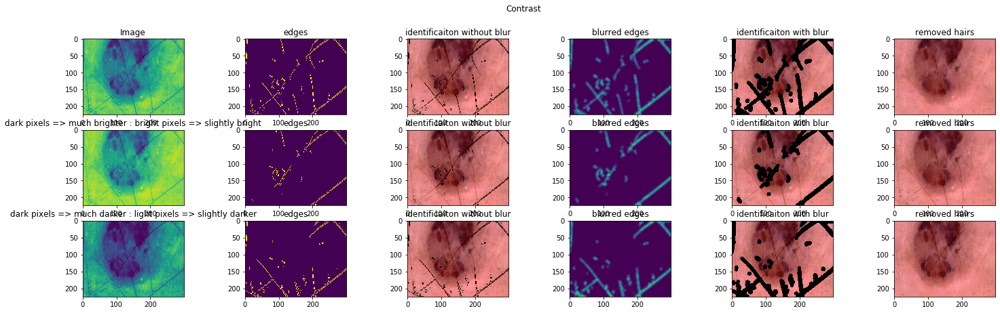

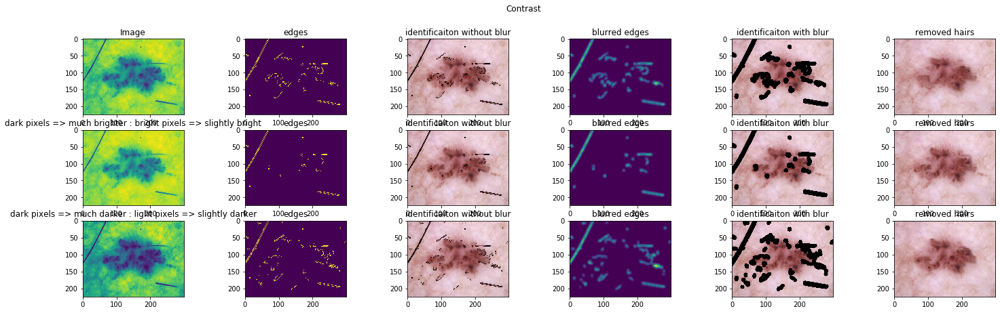

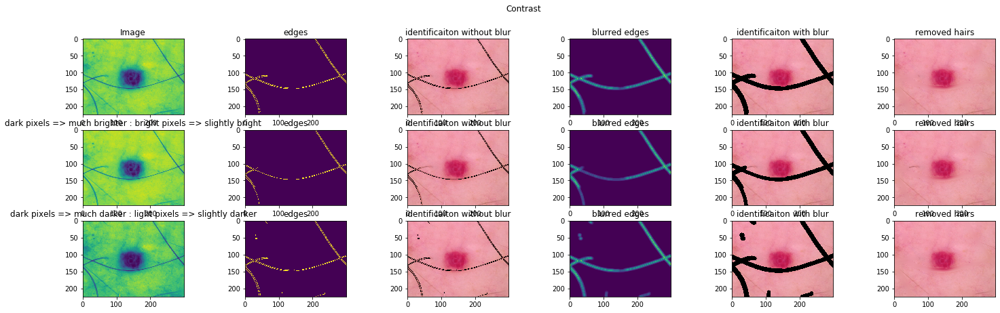

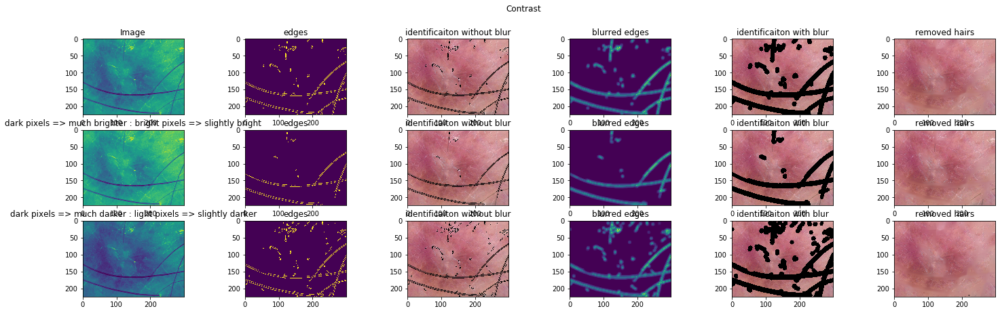

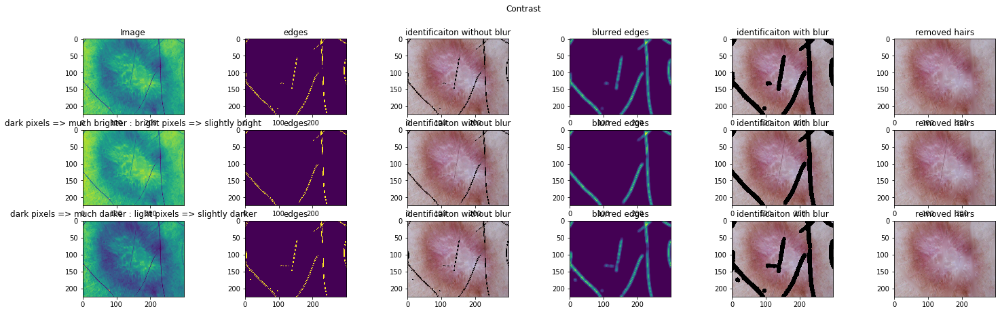

In [6]:
for i in range(len(imageNames)):
    showContrastWithBluredEdgeDetection2(i)

225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
225 300 3
1
1
0
1
1
1
0
1
2
0
2
2rocessed: 9/8 ==> 112.5%                         
0
1rocessed: 10/8 ==> 125.0%                         
2rocessed: 11/8 ==> 137.5%                         
2
0rocessed: 12/8 ==> 150.0%                         
0rocessed: 13/8 ==> 162.5%                         
2
0rocessed: 14/8 ==> 175.0%                         
1
2
2
0


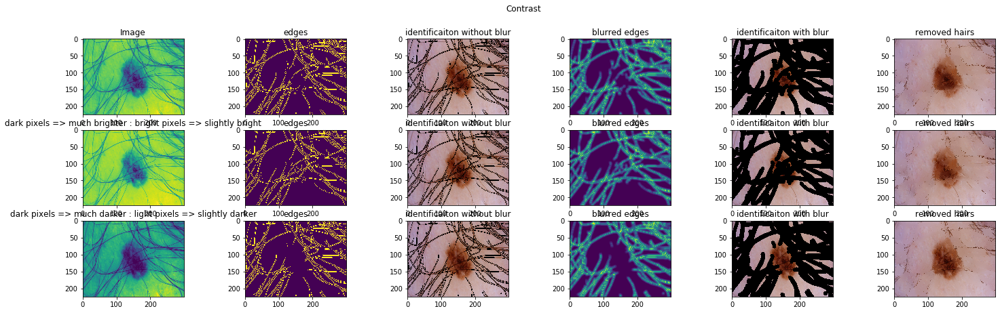

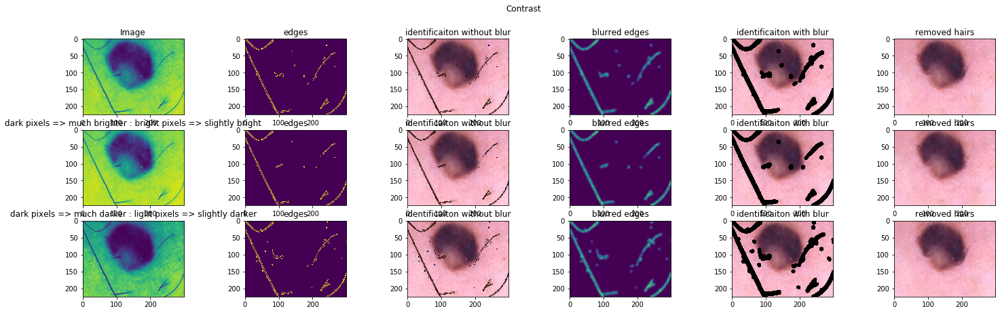

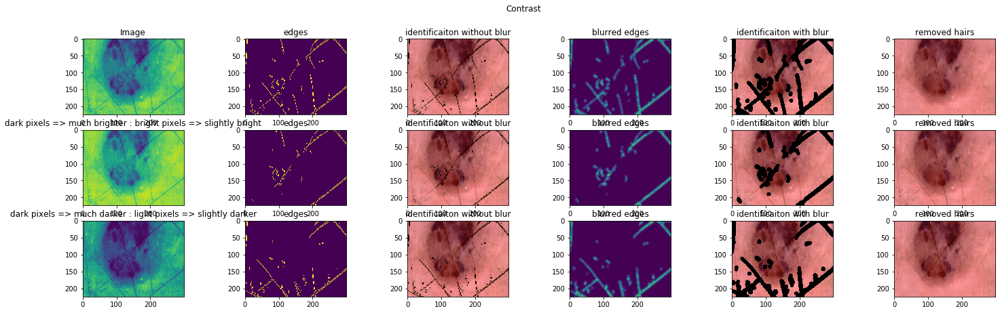

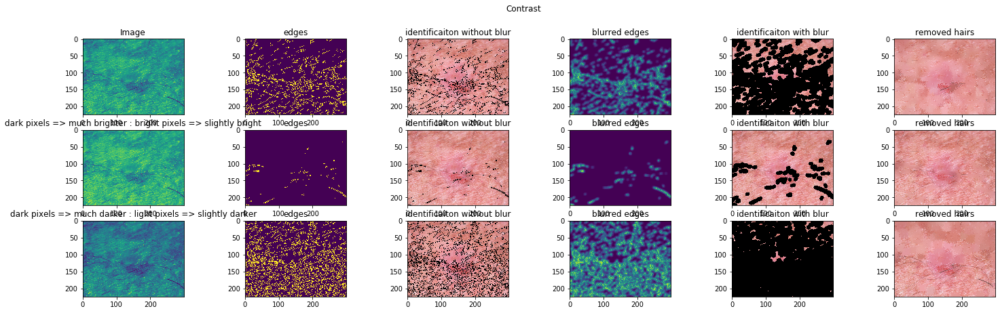

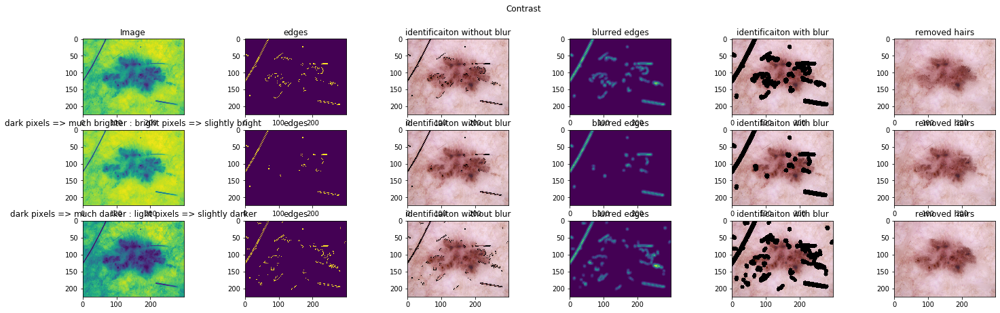

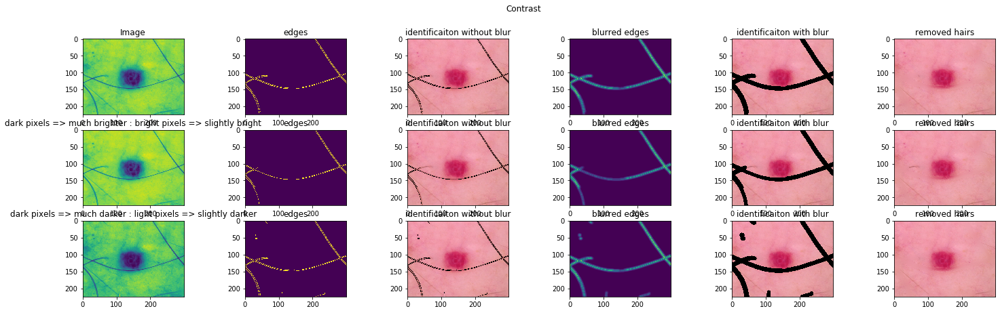

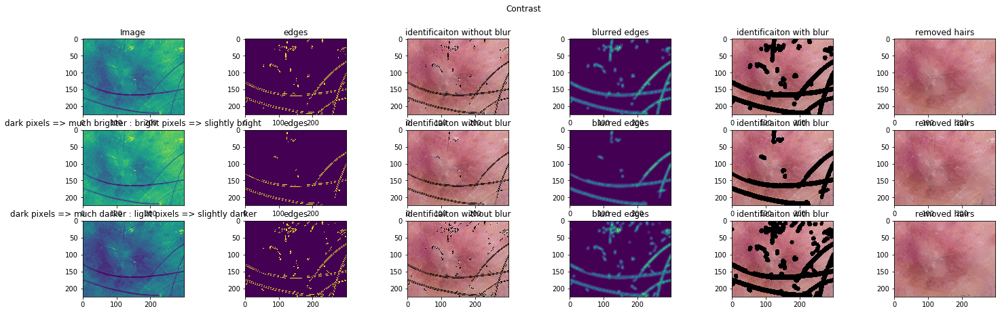

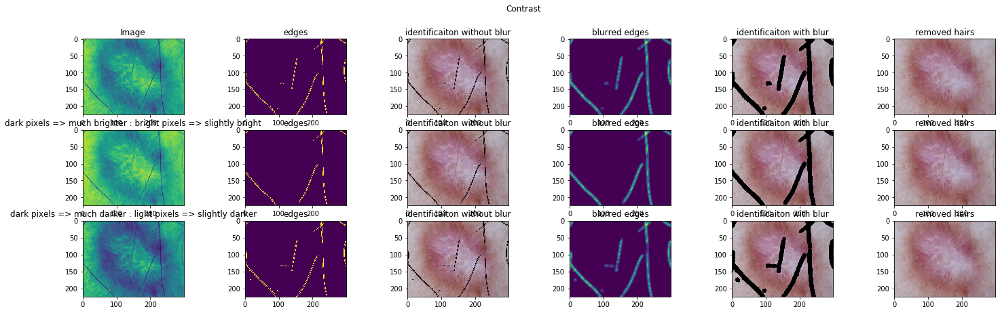

In [11]:
threads = [threading.Thread(target=showContrastWithBluredEdgeDetection4, args=(i,)) for i in range(len(imageNames))]
import time
for t in threads:
    t.start()
    time.sleep(1)
    
for t in threads:
    t.join()

0
1
1
2
0
2
2rocessed: 2/9 ==> 22.2%                         
1
0
1
0rocessed: 3/9 ==> 33.300000000000004%                         
2
1rocessed: 4/9 ==> 44.4%                         
1
0
2
1
0
1
2
0
2rocessed: 6/9 ==> 66.7%                                      
0rocessed: 7/9 ==> 77.8%                         
2


RuntimeError: cannot join thread before it is started

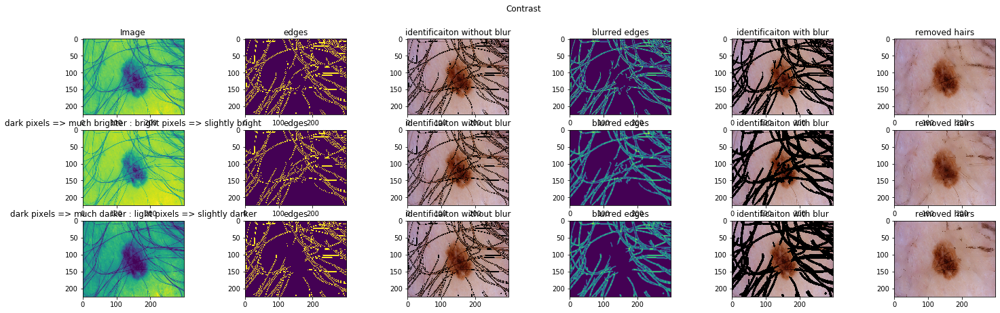

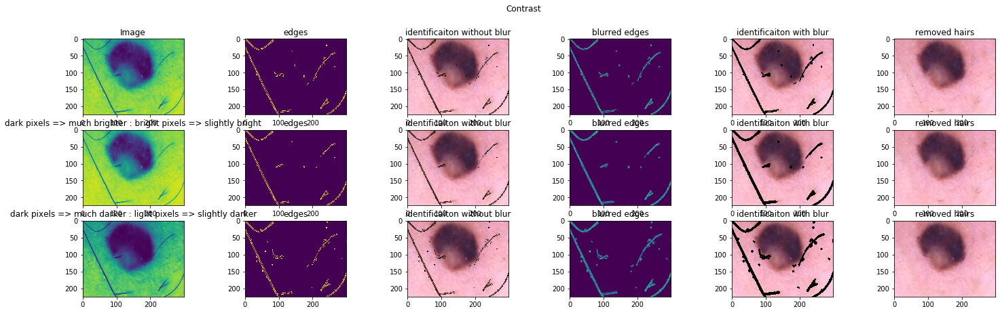

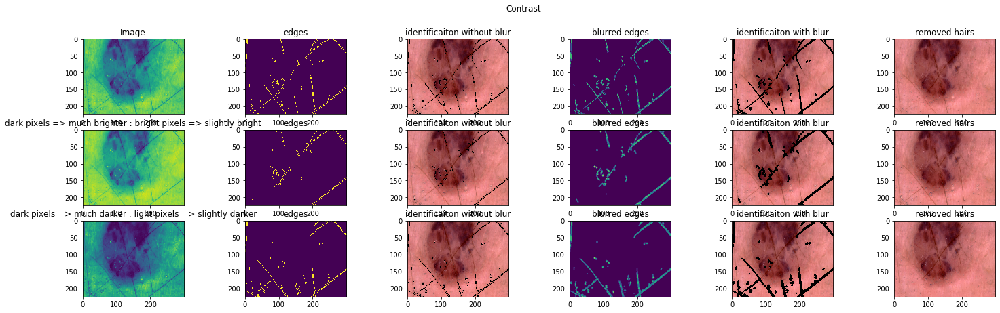

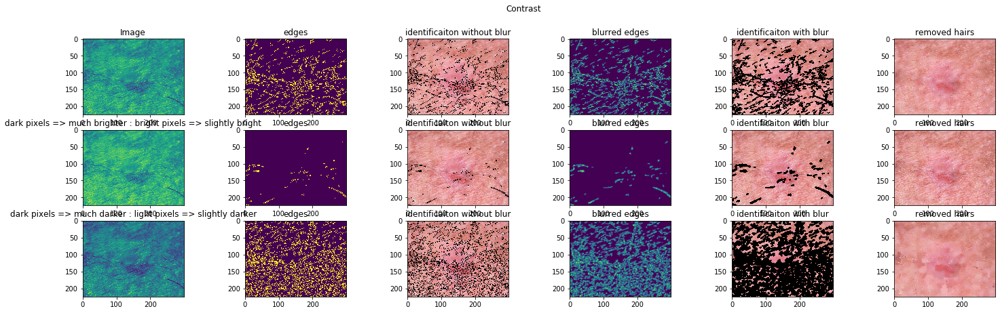

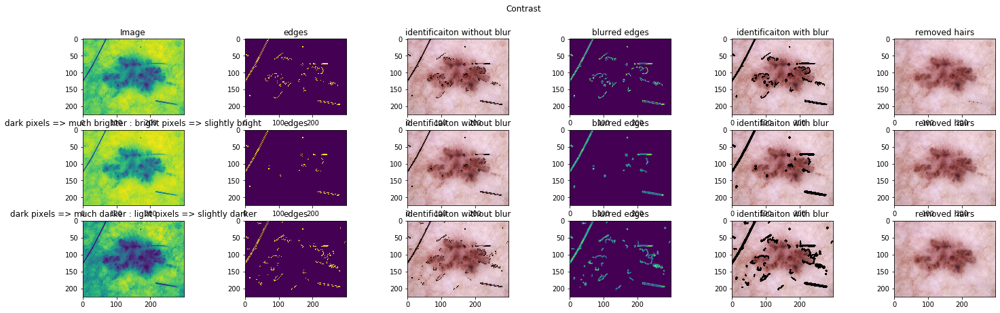

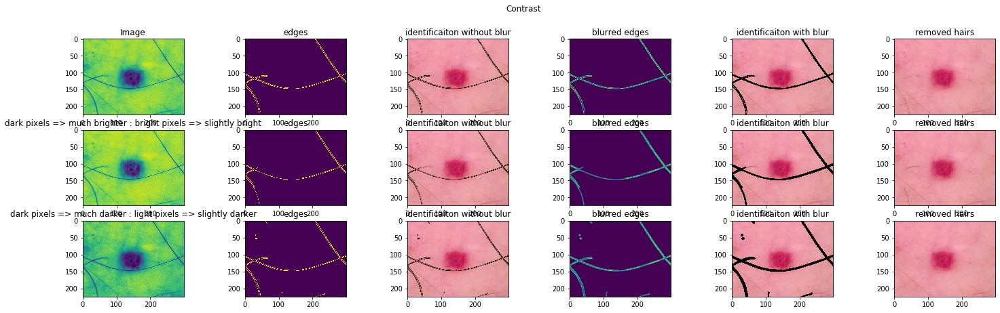

In [23]:
threads = [threading.Thread(target=showContrastWithBluredEdgeDetection4, args=(i,)) for i in range(len(imageNames))]
import time
# for t in threads:
#     t.start()
#     time.sleep(300)
    
for k in range(4):
    t = threads[k]
    t.start()

time.sleep(300)

for k in range(4):
    t = threads[k + 4]
    t.start()

for t in threads:
    t.join()

225 300 3
225 300 3
225 300 3
1
2
0


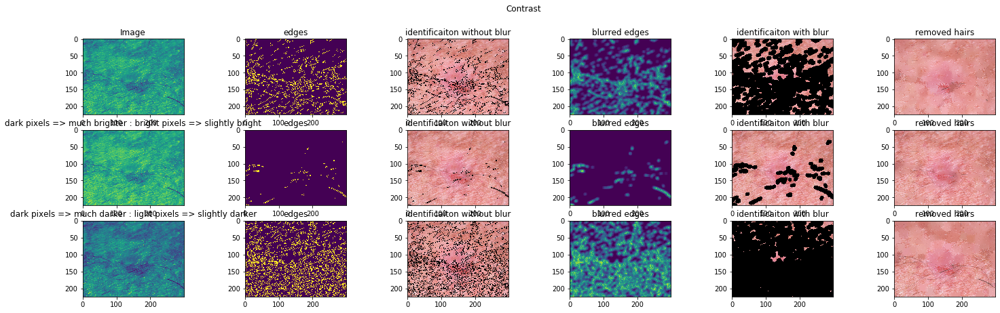

In [7]:
showContrastWithBluredEdgeDetection3(3)

In [8]:
import cv2
import matplotlib.pyplot as plt
from matplotlib.colors import hsv_to_rgb
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors
import colorsys
import threading

imageNames3 = [
    "5436e3c6bae478396759f233.jpg",
    "5aaf1253116597691362835b.jpg",
    "5aaf12ba116597691362b671.jpg",
    "5aaf13841165976913631d42.jpg",
    "5aaf1320116597691362ea91.jpg",
    "5592cfca9fc3c131551458e7.jpg",
    "5436e3b8bae478396759f18d.jpg",
    "5aa304cf1165972a9e9618e5.jpg",
    "559436439fc3c13155146557.jpg"
]

import os
import glob
img_dir = "C:/Users/ava/Desktop/KSU/Year 4/Spring 2020/Senior Project/NewCroppedImages/NewCroppedImages/" # Enter Directory of all images 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)
data = []

imageNames = []

for f1 in files:
#     img = cv2.imread(f1)
    if f1[-28:] in imageNames3:
        imageNames.append(f1)
        
        
def resizeImage(src, scale_percent):

    #calculate the 50 percent of original dimensions
    width = int(src.shape[1] * scale_percent / 100)
    height = int(src.shape[0] * scale_percent / 100)

    # dsize
    dsize = (width, height)

    # resize image
    return cv2.resize(src, dsize)


def readAndConvert(image):
    im = cv2.imread(image)
    return resizeImage(cv2.cvtColor(im, cv2.COLOR_BGR2RGB), 50)

images = [readAndConvert(image)for image in imageNames]

colorSpaceCount = 6

RGB = "RGB"
HSV = "HSV"
LUV = "LUV"
LUV_INVERTED = "LUV_INVERTED"
XYZ = "XYZ"
# "YUV": cv2.cvtColor(im_luv, cv2.COLOR_RGB2YUV),
HSL = "HSL"
# GRAY = "GRAY"

def getImageSpaces(im_RGB):
    return {
        RGB: im_RGB,
        HSV: cv2.cvtColor(im_RGB, cv2.COLOR_RGB2HSV),
        LUV: cv2.cvtColor(im_RGB, cv2.COLOR_RGB2LUV),
        LUV_INVERTED: cv2.bitwise_not(cv2.cvtColor(im_RGB, cv2.COLOR_RGB2LUV)),
        XYZ: cv2.cvtColor(im_RGB, cv2.COLOR_RGB2XYZ),
        # "YUV": cv2.cvtColor(im_luv, cv2.COLOR_RGB2YUV),
        HSL: cv2.cvtColor(im_RGB, cv2.COLOR_RGB2HLS)
#         GRAY: cv2.cvtColor(im_RGB, cv2.COLOR_RGB2GRAY)

    }

save_path = 'C:/Users/ava/Desktop/KSU/Year 4/Spring 2020/Senior Project/figures'

In [9]:
def greenHighlights2(imageIndex, edges):
    indices = np.where(edges >= [40])
    coordinates = zip(indices[0], indices[1])
    
    img2 =  readAndConvert(imageNames[imageIndex])

    for c in coordinates:
        img2[c[0], c[1]] = (0,0,0)
    
    return img2


In [10]:
def getCoordinates(index, radius, w, h):
#     startingCorner = [index[0] - radius, index[1] - radius]
    result = []
    for i in range(index[0] - radius, index[0] + radius + 1):
        if i >= h:
            break
        if i >= 0:
            for j in range(index[1] - radius, index[1] + radius + 1):
                if j >= w:
                    break
                if j >= 0:
                    result.append([i, j])

            
#     print(result)
    return result

In [11]:
from statistics import mean 
from random import randint

# def subBlurHairs(pixels, imageWithBlack, img2):
#     for c in coordinates:
#         x = c[0]
#         y = c[1]
#         r = 0
#         g = 0
#         b = 0
#         count = 0
#         exceptions = 0
#         tempCoordinates = getCoordinates([x,y], randint(5, 8), w, h)#[[x, y+1], [x, y-1], [x+1, y], [x+1, y+1], [x+1, y-1], [x-1, y], [x-1, y+1], [x-1, y-1]]
#         for c2 in tempCoordinates:
#             x2 = c2[0]
#             y2 = c2[1]
#             try:
#                 if imageWithBlack[x2, y2][0] != 0 and imageWithBlack[x2, y2][1] != 0 and imageWithBlack[x2, y2][2] != 0:
#                     r = r + img2[x2, y2][0]
#                     g = g + img2[x2, y2][1]
#                     b = b + img2[x2, y2][2]
#                     count = count + 1
#             except:
#                 exceptions = exceptions + 1
#             if count > 0:
#                 img2[x,y] = [r/count, g/count, b/count]
#             else:
#                 redoPixels.append([x,y])

def blurHairs2(imageIndex, edges, imageWithBlack, allowAnotherIteration=True):
    indices = np.where(edges >= [40])
    coordinates = zip(indices[0], indices[1])
    
    img2 =  readAndConvert(imageNames[imageIndex])        
    h, w, c = img2.shape
#     print(h, w, c)
    unchanged = 0
    changed = 0
    for c in coordinates:
        x = c[0]
        y = c[1]
        r = 0
        g = 0
        b = 0
        count = 0
        exceptions = 0
        tempCoordinates = getCoordinates([x,y], randint(8, 15), w, h)#[[x, y+1], [x, y-1], [x+1, y], [x+1, y+1], [x+1, y-1], [x-1, y], [x-1, y+1], [x-1, y-1]]
        for c2 in tempCoordinates:
            x2 = c2[0]
            y2 = c2[1]
            try:
                if imageWithBlack[x2, y2][0] != 0 and imageWithBlack[x2, y2][1] != 0 and imageWithBlack[x2, y2][2] != 0:
                    r = r + img2[x2, y2][0]
                    g = g + img2[x2, y2][1]
                    b = b + img2[x2, y2][2]
                    count = count + 1
            except:
                exceptions = exceptions + 1
            if count > 0:
                img2[x,y] = [r/count, g/count, b/count]
                changed = changed + 1
            else:
                unchanged = unchanged + 1
#     if unchanged > h * w / 3 and allowAnotherIteration == True:
#         img3 = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)
#         edges3 = cv2.Canny(img3,100,200)
#         edges4 = cv2.bilateralFilter(edges3,7,300,9)
#         blackHighlights = greenHighlights2(imageIndex, edges4)
#         return blurHairs2(imageIndex, edges4, blackHighlights, allowAnotherIteration=False)
        
    return img2

In [6]:
'''
Simple and fast image transforms to mimic:
 - brightness
 - contrast
 - erosion 
 - dilation
'''
import threading
from pylab import array, plot, show, axis, arange, figure, uint8 

def showNoContrast(axs, image, imageNameIndex):
    axs[0, 0].set_title('Image')
    axs[0, 0].imshow(image)
    maxIntensity = 255.0 # depends on dtype of image data
    x = arange(maxIntensity) 
    edges = cv2.Canny(image,100,200)
    axs[0, 1].set_title('edges')
    axs[0, 1].imshow(edges)
    
    axs[0, 2].set_title('identificaiton without blur')
    axs[0, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,10,350,9)
    axs[0, 3].set_title('blurred edges')
    axs[0, 3].imshow(edges2)
    
    axs[0, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[0, 4].imshow(blackHighlights)
    
    axs[0, 5].set_title('removed hairs')
    axs[0, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
    print('0')
    return axs

def showDarkContrast(axs, newImage0, imageNameIndex):
    axs[1, 0].set_title('dark pixels => much brighter : bright pixels => slightly bright')
    axs[1, 0].imshow(newImage0)
    edges = cv2.Canny(newImage0,100,200)
    axs[1, 1].set_title('edges')
    axs[1, 1].imshow(edges)
    
    axs[1, 2].set_title('identificaiton without blur')
    axs[1, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,10,350,9)
    axs[1, 3].set_title('blurred edges')
    axs[1, 3].imshow(edges2)
    
    axs[1, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[1, 4].imshow(blackHighlights)
    
    axs[1, 5].set_title('removed hairs')
    axs[1, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
    print('1')
    return axs

def showLightContrast(axs, newImage1, imageNameIndex):
    axs[2, 0].set_title('dark pixels => much darker : light pixels => slightly darker')
    axs[2, 0].imshow(newImage1)
    edges = cv2.Canny(newImage1,100,200)
    axs[2, 1].set_title('edges')
    axs[2, 1].imshow(edges)
    
    axs[2, 2].set_title('identificaiton without blur')
    axs[2, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,10,350,9)
    axs[2, 3].set_title('blurred edges')
    axs[2, 3].imshow(edges2)
    
    axs[2, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[2, 4].imshow(blackHighlights)
    
    axs[2, 5].set_title('removed hairs')
    axs[2, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
    print('2')
    return axs


def showContrastWithBluredEdgeDetection3(imageNameIndex):

    row = 3
    col = 6

    fig2, axs = plt.subplots(row,col,  figsize=(25,7))
    fig2.suptitle('Contrast')


    # Image data
    image = resizeImage(cv2.imread(imageNames[imageNameIndex],0), 50) # load as 1-channel 8bit grayscale
    maxIntensity = 255.0 # depends on dtype of image data
    x = arange(maxIntensity) 
    
    t = threading.Thread(target = showNoContrast, args = (axs, image, imageNameIndex ))
    t.start()

    # Parameters for manipulating image data
    phi = 1
    theta = 1

    # Increase intensity such that
    # dark pixels become much brighter, 
    # bright pixels become slightly bright
    newImage0 = (maxIntensity/phi)*(image/(maxIntensity/theta))**0.5
    newImage0 = array(newImage0,dtype=uint8)

    t0 = threading.Thread(target = showDarkContrast, args = (axs, newImage0, imageNameIndex ))
    t0.start()

    y = (maxIntensity/phi)*(x/(maxIntensity/theta))**0.5

    # Decrease intensity such that
    # dark pixels become much darker, 
    # bright pixels become slightly dark 
    newImage1 = (maxIntensity/phi)*(image/(maxIntensity/theta))**2
    newImage1 = array(newImage1,dtype=uint8)

    t1 = threading.Thread(target = showLightContrast, args = (axs, newImage1, imageNameIndex))
    t1.start()

    t.join()
    t0.join()
    t1.join()

    z = (maxIntensity/phi)*(x/(maxIntensity/theta))**2

In [12]:
lck = threading.Lock()
numberOfProcessedImages = 0
def writeToFile(index, fig2):
    global lck
    lck.acquire()
    global numberOfProcessedImages
#     cv2.imwrite(path + imageNames[index][-28:], img)
    fig2.savefig(save_path + imageNames[index][-28:-4] +".png")
    numberOfProcessedImages = numberOfProcessedImages + 1
    print(str("Processed: " + str(numberOfProcessedImages) + "/" + str(len(imageNames)) + " ==> " + str(round((numberOfProcessedImages / len(imageNames)), 3) * 100) + "%"),
          end="                         \r", flush=True)
    lck.release()

In [14]:
#showContrastWithBluredEdgeDetection4
'''
Simple and fast image transforms to mimic:
 - brightness
 - contrast
 - erosion 
 - dilation
'''
import threading
from pylab import array, plot, show, axis, arange, figure, uint8 

def showNoContrast(axs, image, imageNameIndex):
    axs[0, 0].set_title('Image')
    axs[0, 0].imshow(image)
    maxIntensity = 255.0 # depends on dtype of image data
    x = arange(maxIntensity) 
    edges = cv2.Canny(image,100,200)
    axs[0, 1].set_title('edges')
    axs[0, 1].imshow(edges, cmap='gray')
    
    axs[0, 2].set_title('identificaiton without blur')
    axs[0, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,7,300,9)
    axs[0, 3].set_title('blurred edges')
    axs[0, 3].imshow(edges2, cmap='gray')
    
    axs[0, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[0, 4].imshow(blackHighlights)
    
    axs[0, 5].set_title('removed hairs')
    axs[0, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
#     print('0')
    return axs

def showDarkContrast(axs, newImage0, imageNameIndex):
    axs[1, 0].set_title('dark pixels => much brighter : bright pixels => slightly bright')
    axs[1, 0].imshow(newImage0)
    edges = cv2.Canny(newImage0,100,200)
    axs[1, 1].set_title('edges')
    axs[1, 1].imshow(edges, cmap='gray')
    
    axs[1, 2].set_title('identificaiton without blur')
    axs[1, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,7,300,9)
    axs[1, 3].set_title('blurred edges')
    axs[1, 3].imshow(edges2, cmap='gray')
    
    axs[1, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[1, 4].imshow(blackHighlights)
    
    axs[1, 5].set_title('removed hairs')
    axs[1, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
#     print('1')
    return axs

def showLightContrast(axs, newImage1, imageNameIndex):
    axs[2, 0].set_title('dark pixels => much darker : light pixels => slightly darker')
    axs[2, 0].imshow(newImage1)
    edges = cv2.Canny(newImage1,100,200)
    axs[2, 1].set_title('edges')
    axs[2, 1].imshow(edges, cmap='gray')
    
    axs[2, 2].set_title('identificaiton without blur')
    axs[2, 2].imshow(greenHighlights2(imageNameIndex, edges))
    
    edges2 =cv2.bilateralFilter(edges,7,300,9)
    axs[2, 3].set_title('blurred edges')
    axs[2, 3].imshow(edges2, cmap='gray')
    
    axs[2, 4].set_title('identificaiton with blur')
    blackHighlights = greenHighlights2(imageNameIndex, edges2)
    axs[2, 4].imshow(blackHighlights)
    
    axs[2, 5].set_title('removed hairs')
    axs[2, 5].imshow(blurHairs2(imageNameIndex, edges2, blackHighlights))
#     print('2')
    return axs

import os
def showContrastWithBluredEdgeDetection4(imageNameIndex):


    row = 3
    col = 6

    fig2, axs = plt.subplots(row,col,  figsize=(25,7))
    fig2.suptitle('Contrast')


    # Image data
    image = resizeImage(cv2.imread(imageNames[imageNameIndex],0), 50) # load as 1-channel 8bit grayscale
#     maxIntensity = 255.0 # depends on dtype of image data
#     x = arange(maxIntensity) 
    
#     t = threading.Thread(target = showNoContrast, args = (axs, image, imageNameIndex ))
#     t.start()

#     # Parameters for manipulating image data
#     phi = 1
#     theta = 1

#     # Increase intensity such that
#     # dark pixels become much brighter, 
#     # bright pixels become slightly bright
#     newImage0 = (maxIntensity/phi)*(image/(maxIntensity/theta))**0.5
#     newImage0 = array(newImage0,dtype=uint8)

#     t0 = threading.Thread(target = showDarkContrast, args = (axs, newImage0, imageNameIndex ))
#     t0.start()

#     y = (maxIntensity/phi)*(x/(maxIntensity/theta))**0.5

#     # Decrease intensity such that
#     # dark pixels become much darker, 
#     # bright pixels become slightly dark 
#     newImage1 = (maxIntensity/phi)*(image/(maxIntensity/theta))**2
#     newImage1 = array(newImage1,dtype=uint8)

#     t1 = threading.Thread(target = showLightContrast, args = (axs, newImage1, imageNameIndex))
#     t1.start()

#     t.join()
#     t0.join()
#     t1.join()

#     z = (maxIntensity/phi)*(x/(maxIntensity/theta))**2
    showNoContrast(axs, image, imageNameIndex)
    writeToFile(imageNameIndex, fig2)

In [31]:
edges = cv2.Canny(images[7],100,200)
edges =cv2.bilateralFilter(edges,4,300,9)
print(type(edges))
print(edges)
print("\n\n")
for i in range(len(edges)):
    print(edges[0][i], edges[1][i])

<class 'numpy.ndarray'>
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]



0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
13 28
77 60
99 120
95 95
140 120
44 44
13 13
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 14
28 44
59 60
77 120
77 120
99 95
95 77
99 99
44 28
13 13
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0

0
1
1
2
2
0


RuntimeError: threads can only be started once

1
0
0
2
2
1
2
0rocessed: 3/9 ==> 33.300000000000004%                         
1


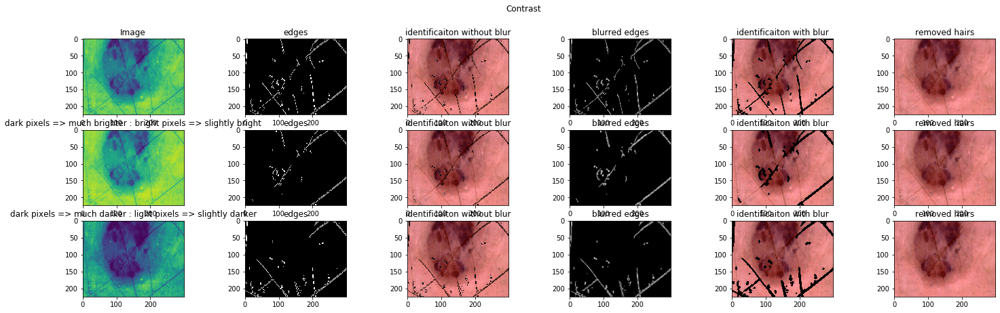

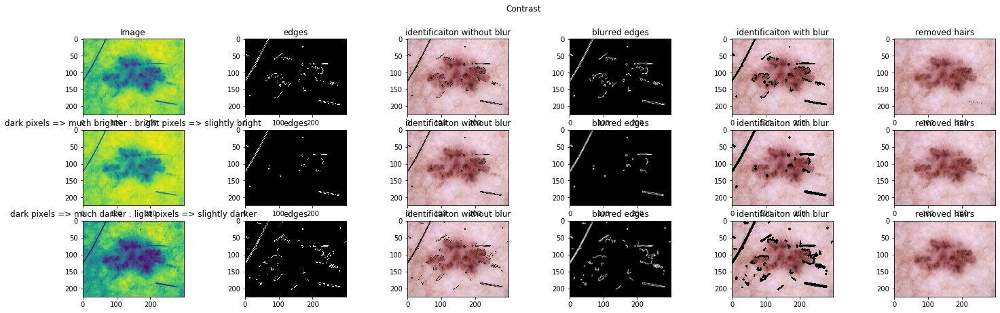

In [7]:
threads = [threading.Thread(target=showContrastWithBluredEdgeDetection4, args=(i,)) for i in range(len(imageNames))]
import time
# for t in threads:
#     t.start()
#     time.sleep(300)
    
for k in range(4):
    t = threads[k]
    t.start()

time.sleep(100)

while numberOfProcessedImages < len(imageNames):
    for k in range(4):
        if threads[k].isAlive() == False:
            threads[k+4].start()
    time.sleep(5)

for t in threads:
    t.join()

0
1
1
0
2
2
0rocessed: 2/9 ==> 22.2%                         
1
1
0
2
1
0
2rocessed: 3/9 ==> 33.300000000000004%                         
0
2
2
1rocessed: 4/9 ==> 44.4%                         


RuntimeError: cannot join thread before it is started

1


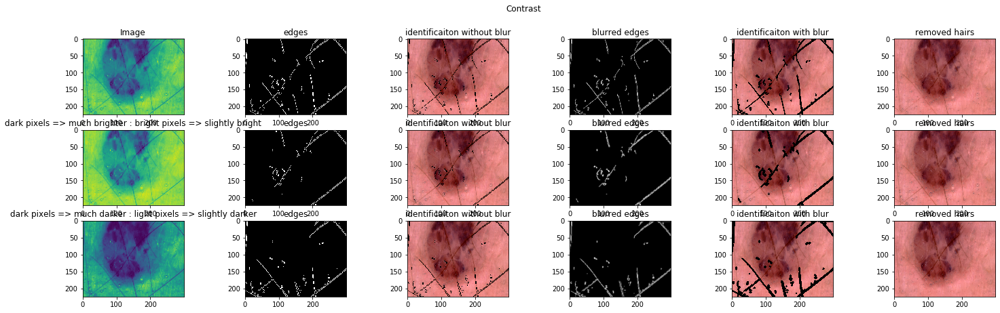

0


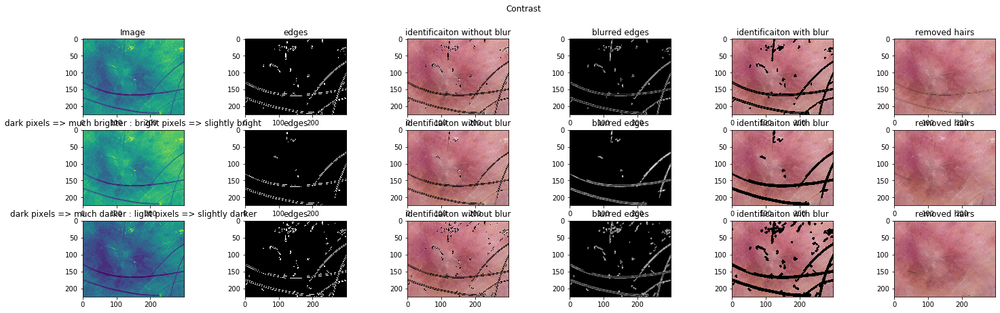

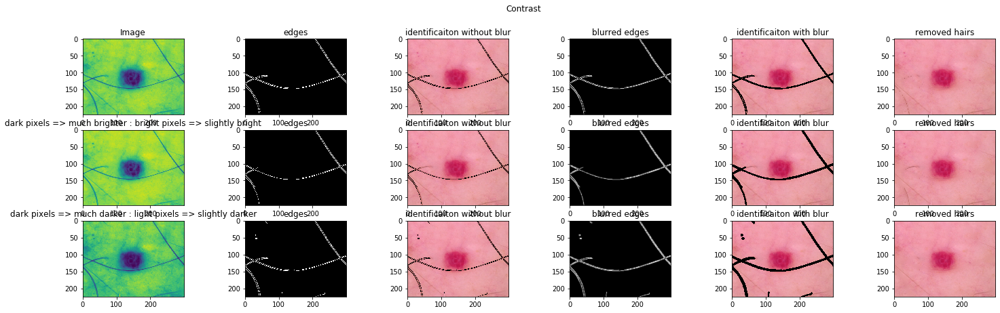

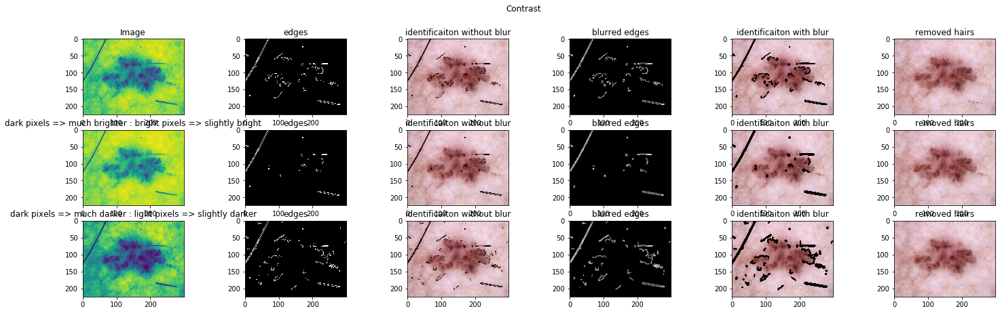

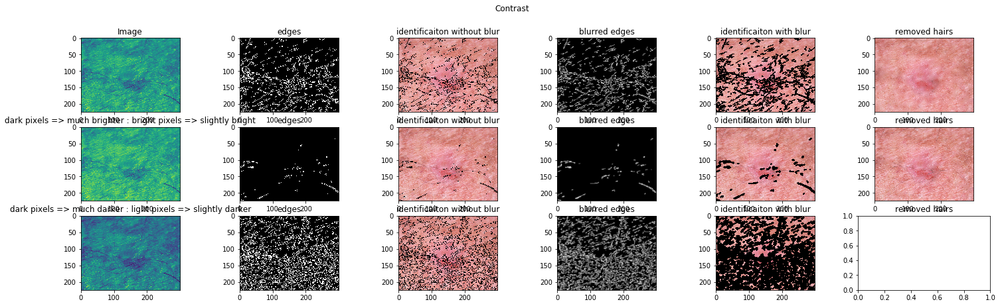

In [7]:
threads = [threading.Thread(target=showContrastWithBluredEdgeDetection4, args=(i,)) for i in range(len(imageNames))]
import time
# for t in threads:
#     t.start()
#     time.sleep(300)
    
for k in range(3):
    t = threads[k]
    t.start()

time.sleep(100)

startedThreads = []

while numberOfProcessedImages < len(imageNames):
    for k in range(4):
        if threads[k].isAlive() == False and k+4 not in startedThreads:
            threads[k+4].start()
            startedThreads.append(k+4)
    if len(startedThreads) == 4:
        break
    time.sleep(5)

for t in threads:
    t.join()

In [10]:
edges = cv2.Canny(images[7],100,200)
edges =cv2.bilateralFilter(edges,4,300,9)
print(type(edges))
print(edges)
print("\n\n")
for i in range(len(edges)):
    print(edges[0][i], edges[1][i])

print("\n\n")
indices = np.where(edges >= [70])
coordinates = zip(indices[0], indices[1])
for c in coordinates:
    print(c[0], c[1])

<class 'numpy.ndarray'>
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]



0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
13 28
77 60
99 120
95 95
140 120
44 44
13 13
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 14
28 44
59 60
77 120
77 120
99 95
95 77
99 99
44 28
13 13
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0
0 0

0
1
2


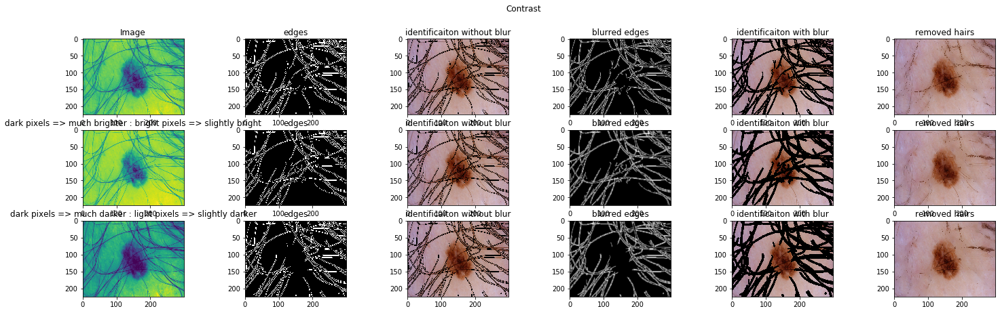

In [16]:
showContrastWithBluredEdgeDetection4(0)

0
1
1
2
2
0
1rocessed: 1/9 ==> 11.1%                         
0
1
0
1
0rocessed: 2/9 ==> 22.2%                         
1
2
2
1
0
2
1
2
0
2rocessed: 3/9 ==> 33.300000000000004%                         
2rocessed: 4/9 ==> 44.4%                         
0
0
1
Processed: 6/9 ==> 66.7%                                      
Done
2rocessed: 8/9 ==> 88.9%                         


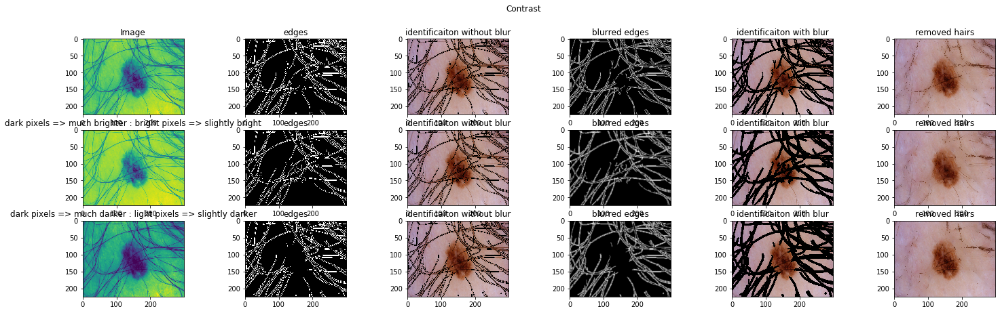

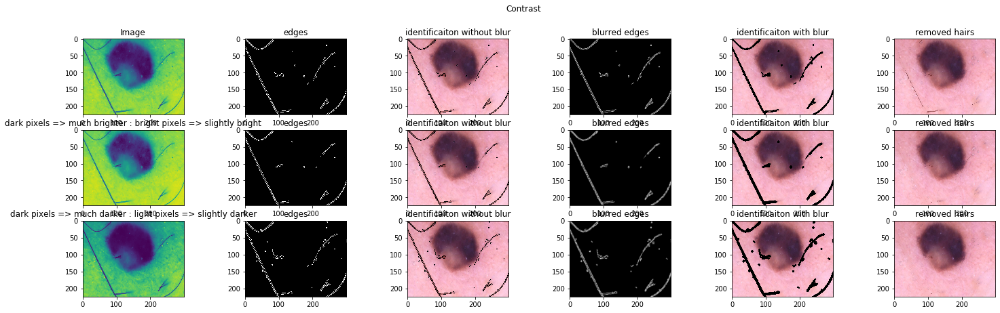

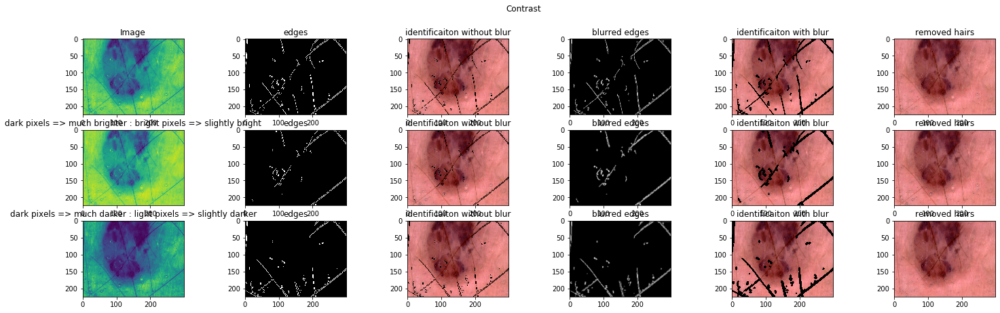

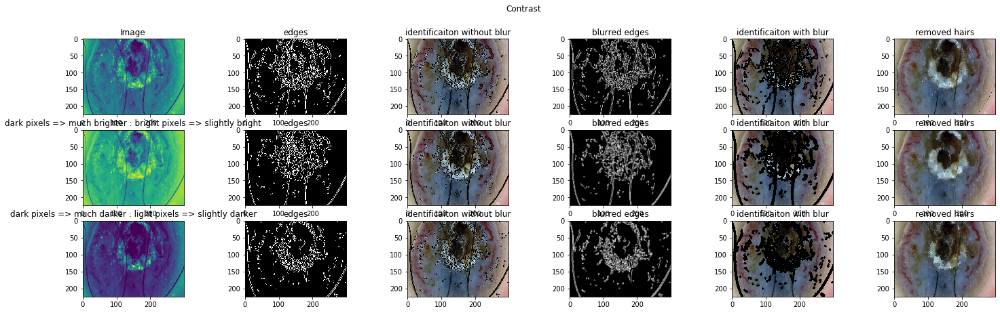

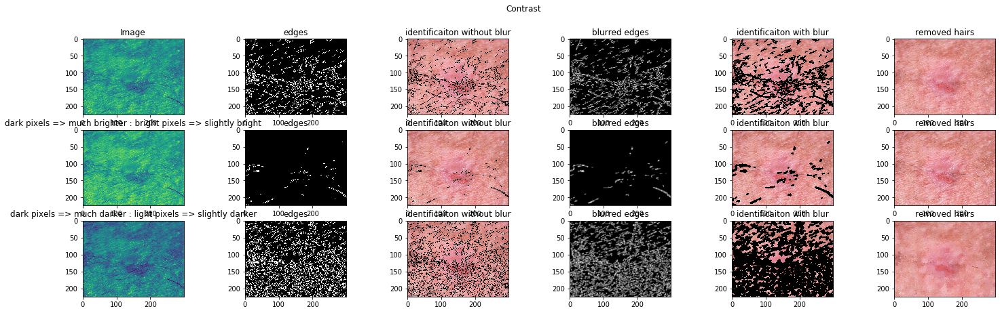

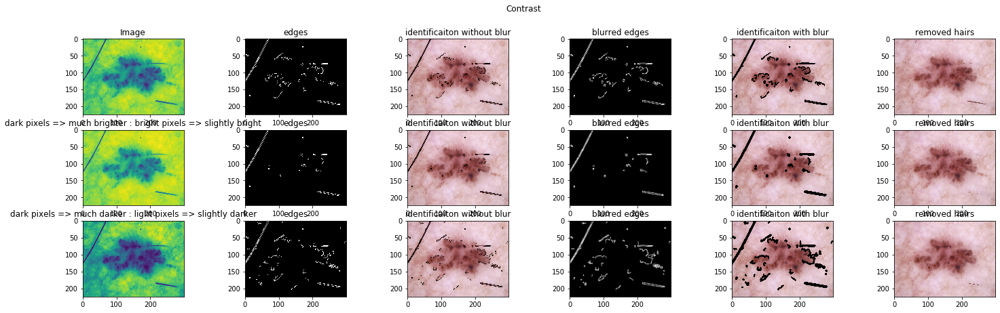

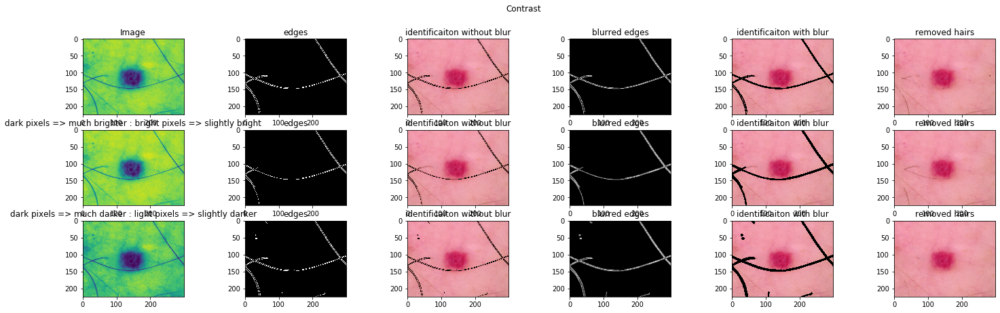

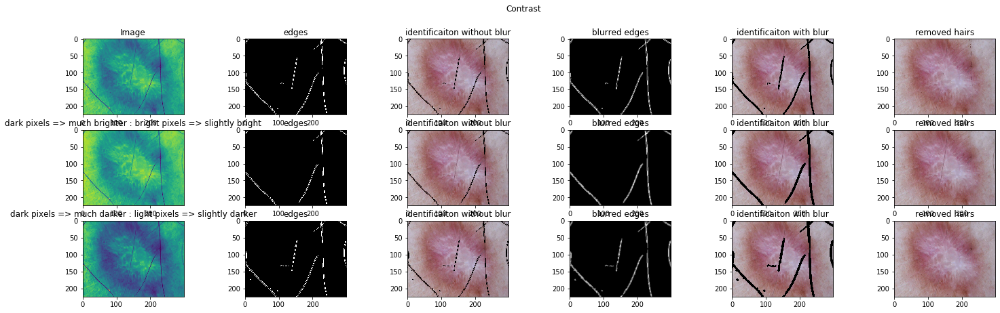

In [23]:
import time
numberOfStartedImages = 3

threads = []
def startNewThreads(numberOfStartedImages):
    temp = numberOfStartedImages
    for t in threads:
        if t.isAlive() == False:
            t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (temp, ))
            t.start()
            temp = temp + 1
#             if temp % 10 == 0:
#                 print("numberOfStartedImages", temp)
    return temp


for i in range(numberOfStartedImages):
    t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (i, ))
    threads.append(t)
    t.start()
    time.sleep(1)

while numberOfStartedImages < len(imageNames):
    temp = numberOfStartedImages
    numberOfStartedImages = startNewThreads(numberOfStartedImages)
    if numberOfStartedImages == temp:
        time.sleep(15)
        
for t in threads:
    t.join()
    
print('\nDone')

Processed: 6/9 ==> 66.7%                                       
Done


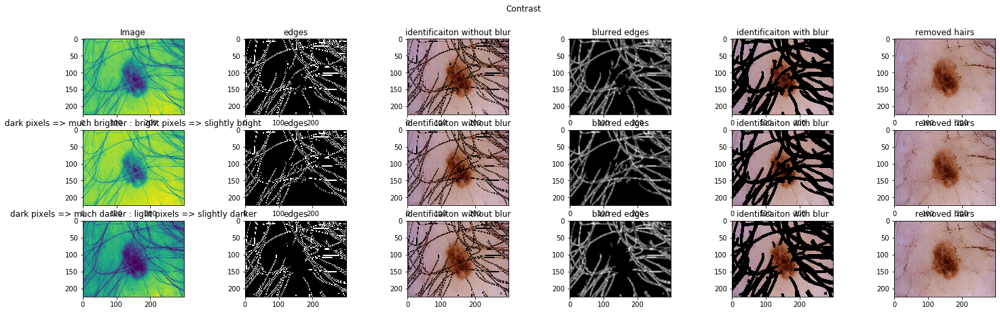

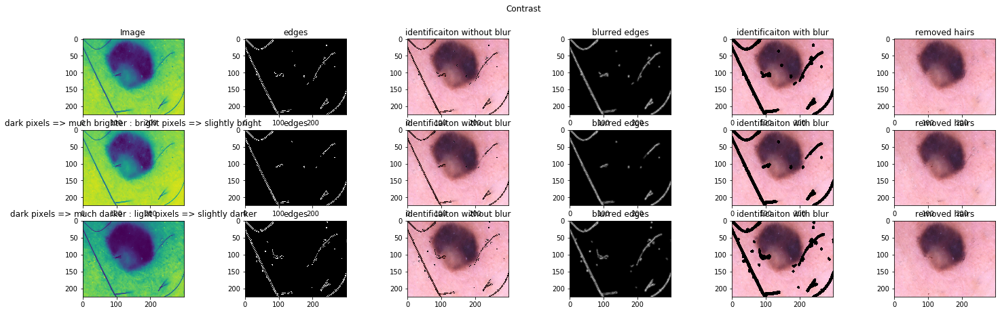

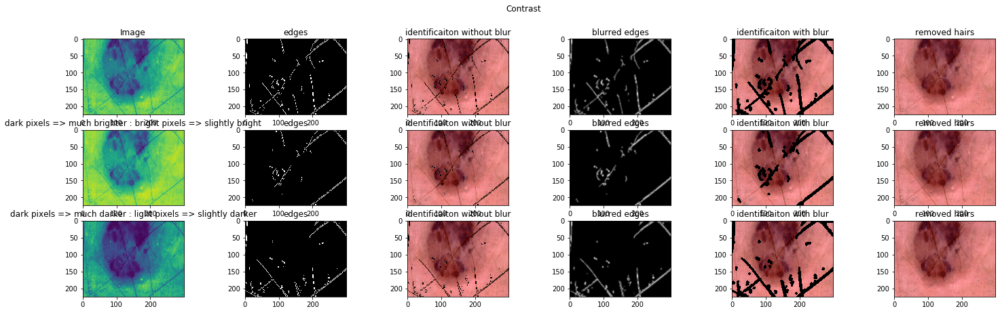

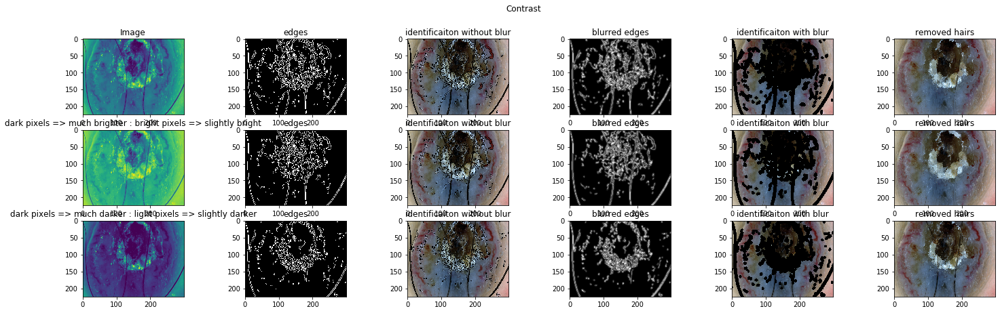

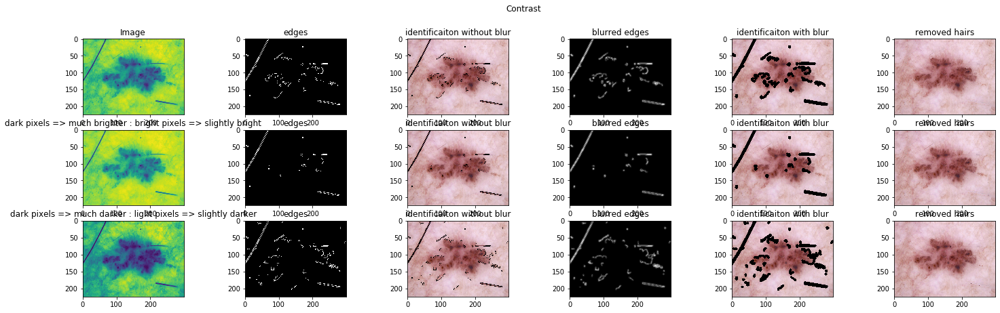

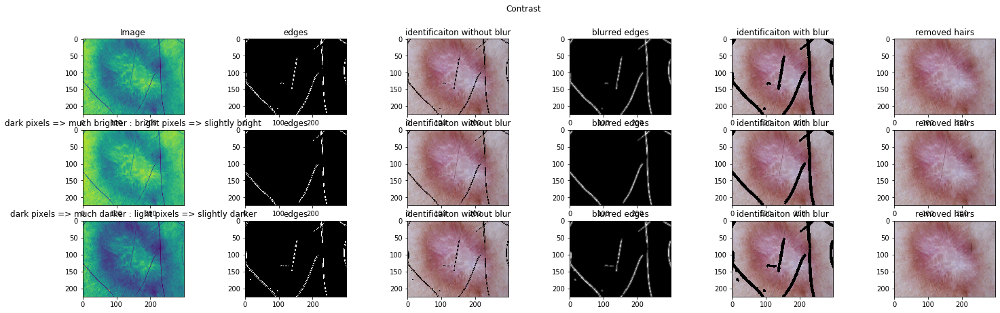

In [7]:
import time
numberOfStartedImages = 3

threads = []
def startNewThreads(numberOfStartedImages):
    temp = numberOfStartedImages
    for t in threads:
        if t.isAlive() == False:
            t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (temp, ))
            t.start()
            temp = temp + 1
#             if temp % 10 == 0:
#                 print("numberOfStartedImages", temp)
    return temp


for i in range(numberOfStartedImages):
    t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (i, ))
    threads.append(t)
    t.start()
    time.sleep(1)

while numberOfStartedImages < len(imageNames):
    temp = numberOfStartedImages
    numberOfStartedImages = startNewThreads(numberOfStartedImages)
    if numberOfStartedImages == temp:
        time.sleep(15)
        
for t in threads:
    t.join()
    
print('\nDone')

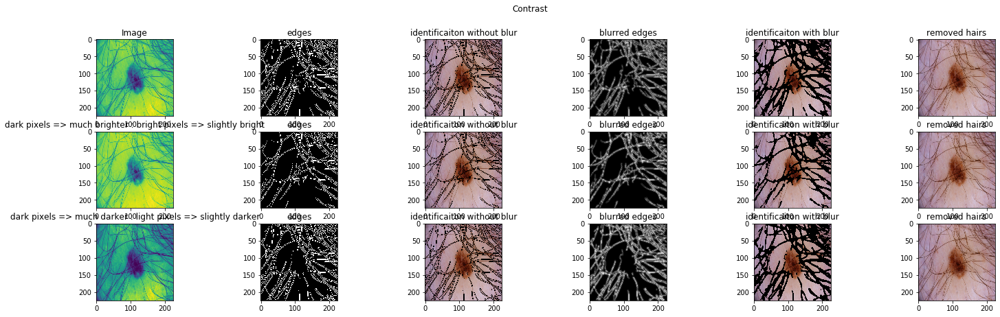

In [7]:
showContrastWithBluredEdgeDetection4(0)

In [ ]:
import time
numberOfStartedImages = 3

threads = []
def startNewThreads(numberOfStartedImages):
    temp = numberOfStartedImages
    for t in threads:
        if t.isAlive() == False:
            t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (temp, ))
            t.start()
            temp = temp + 1
#             if temp % 10 == 0:
            global numberOfProcessedImages
            print("numberOfStartedImages:", temp, "numberOdProcessedImages:", numberOfProcessedImages)
    return temp


for i in range(numberOfStartedImages):
    t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (i, ))
    threads.append(t)
    t.start()
    time.sleep(1)

while numberOfStartedImages < 9:
    temp = numberOfStartedImages
    numberOfStartedImages = startNewThreads(numberOfStartedImages)
    if numberOfStartedImages == temp:
        time.sleep(5)
        
for t in threads:
    t.join()
    
print('\nDone')

numberOfStartedImages: 4 numberOdProcessedImages: 1
numberOfStartedImages: 5 numberOdProcessedImages: 1
numberOfStartedImages: 6 numberOdProcessedImages: 1
numberOfStartedImages: 7 numberOdProcessedImages: 1
numberOfStartedImages: 8 numberOdProcessedImages: 1
numberOfStartedImages: 9 numberOdProcessedImages: 1


numberOfStartedImages: 1 numberOdProcessedImages: 0
numberOfStartedImages: 2 numberOdProcessedImages: 0
numberOfStartedImages: 3 numberOdProcessedImages: 1
numberOfStartedImages: 4 numberOdProcessedImages: 3            
numberOfStartedImages: 5 numberOdProcessedImages: 3
numberOfStartedImages: 6 numberOdProcessedImages: 5           
numberOfStartedImages: 7 numberOdProcessedImages: 5
numberOfStartedImages: 8 numberOdProcessedImages: 7
numberOfStartedImages: 9 numberOdProcessedImages: 7
Processed: 9/9 ==> 100.0%                         
Done


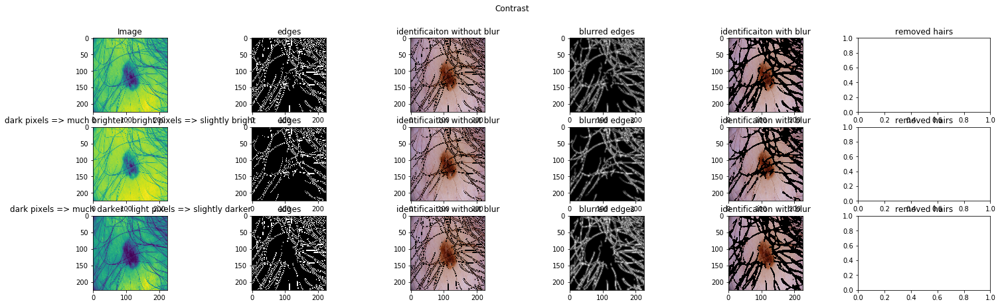

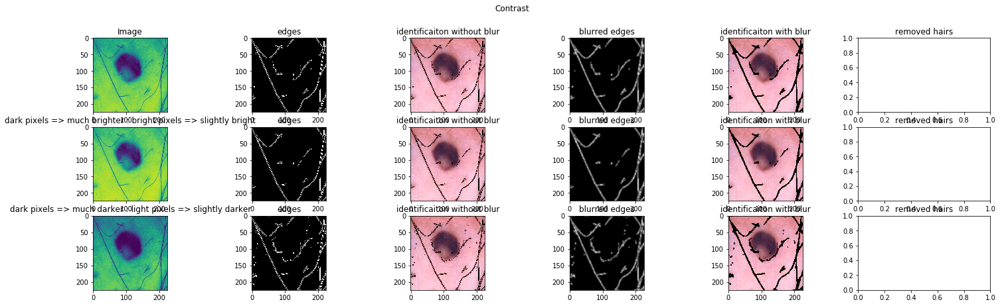

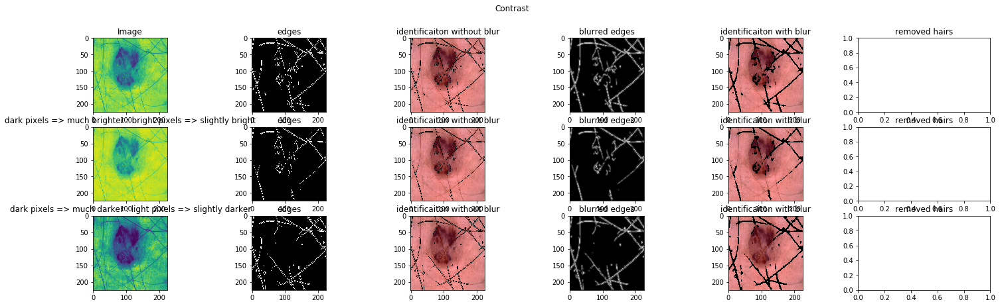

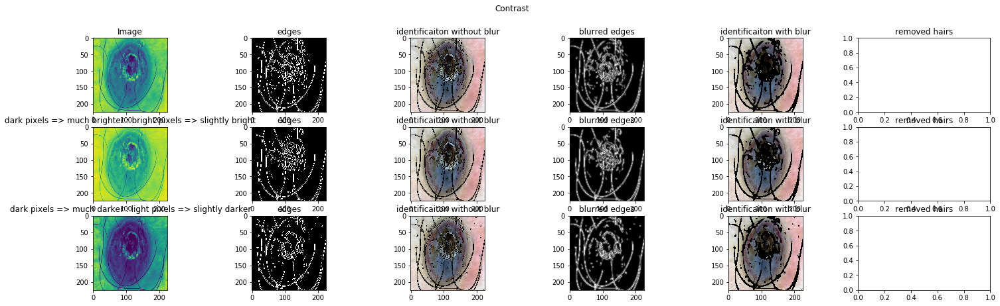

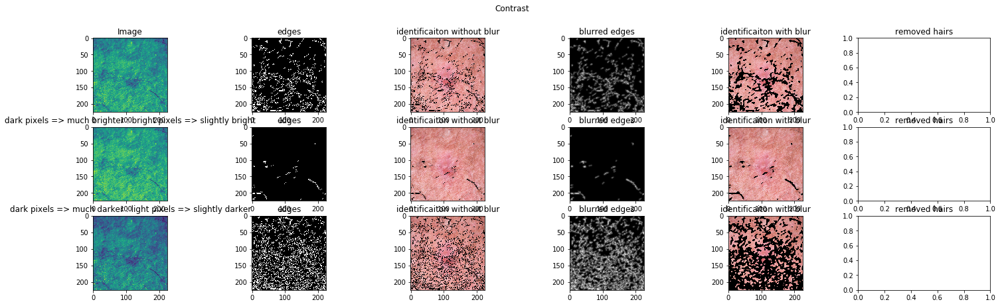

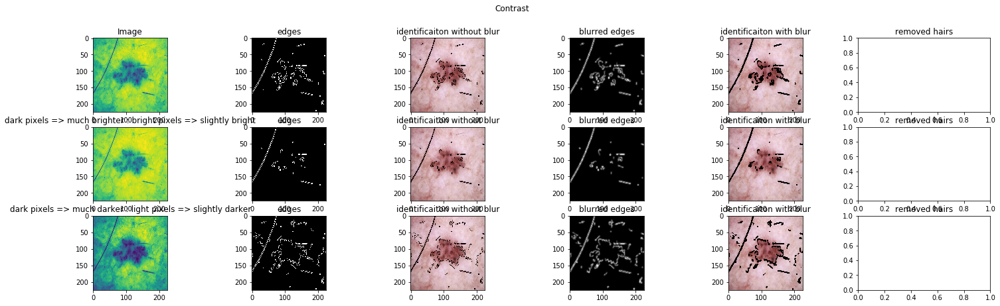

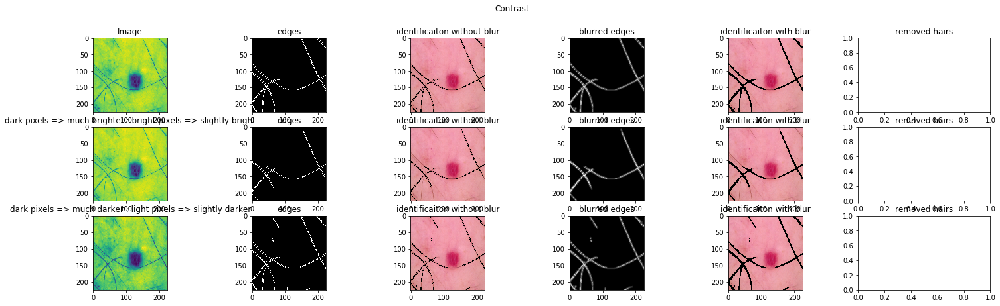

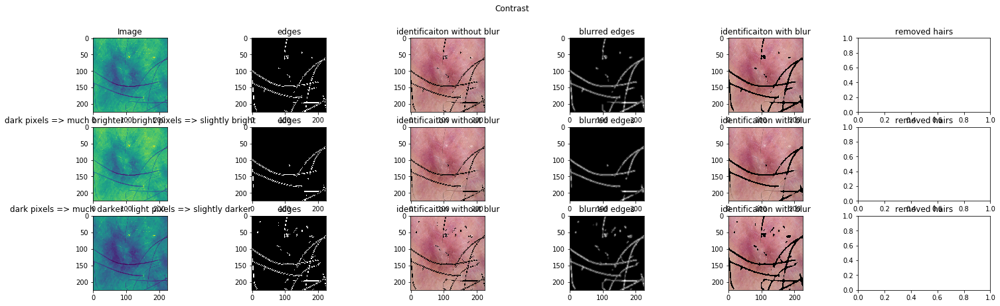

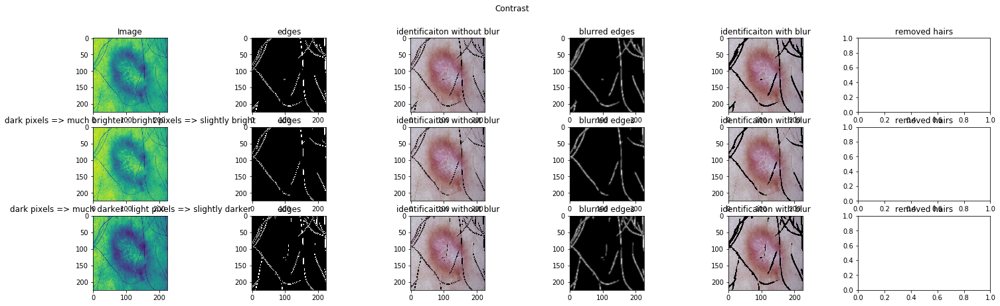

In [7]:
import time
numberOfStartedImages = 0

threads = []
def startNewThreads(numberOfStartedImages):
    temp = numberOfStartedImages
    for t in threads:
        if t.isAlive() == False:
            t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (temp, ))
            t.start()
            temp = temp + 1
#             if temp % 10 == 0:
            global numberOfProcessedImages
            print("numberOfStartedImages:", temp, "numberOdProcessedImages:", numberOfProcessedImages)
            if temp - numberOfStartedImages > 2:
                return temp
    return temp


for i in range(2):
    t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (i, ))
    threads.append(t)
    t.start()
    numberOfStartedImages = numberOfStartedImages + 1
    print("numberOfStartedImages:", numberOfStartedImages, "numberOdProcessedImages:", numberOfProcessedImages)
    time.sleep(1)

while numberOfStartedImages < 8:
    temp = numberOfStartedImages
    numberOfStartedImages = startNewThreads(numberOfStartedImages)
    if numberOfStartedImages == temp:
        time.sleep(5)
    else:
        time.sleep(30)
        
for t in threads:
    t.join()
    
print('\nDone')

numberOfStartedImages: 1 numberOdProcessedImages: 0
numberOfStartedImages: 2 numberOdProcessedImages: 0
numberOfStartedImages: 3 numberOdProcessedImages: 1
numberOfStartedImages: 4 numberOdProcessedImages: 1
numberOfStartedImages: 5 numberOdProcessedImages: 1
numberOfStartedImages: 6 numberOdProcessedImages: 1
numberOfStartedImages: 7 numberOdProcessedImages: 1
numberOfStartedImages: 8                         numberOdProcessedImages: 2
Processed: 4/9 ==> 44.4%                                       
Done


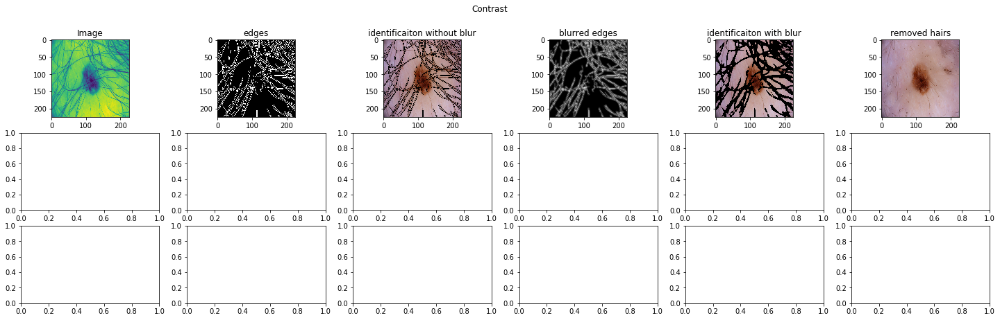

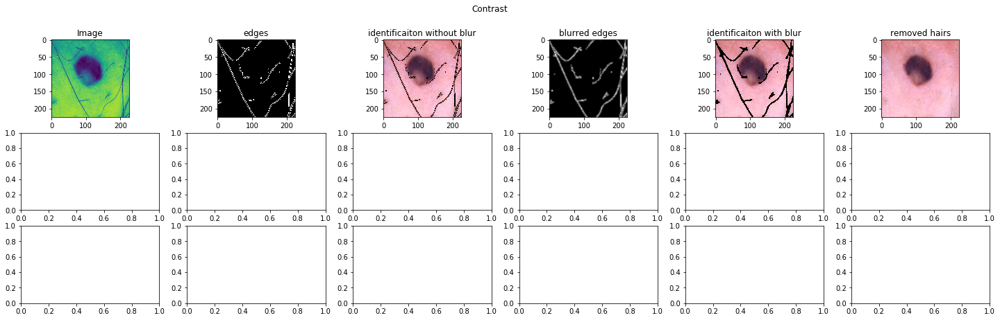

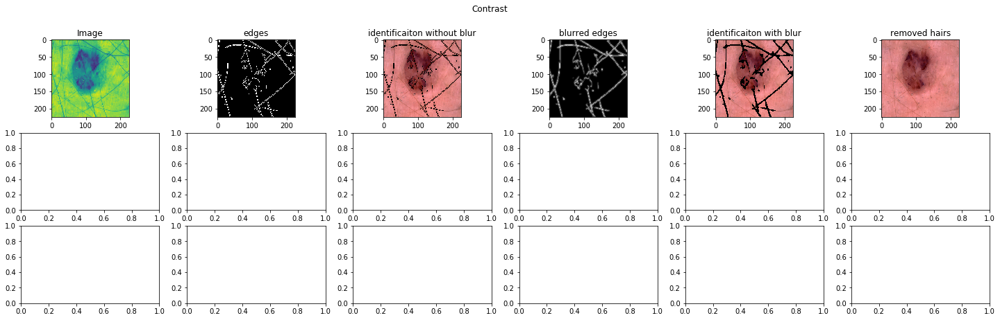

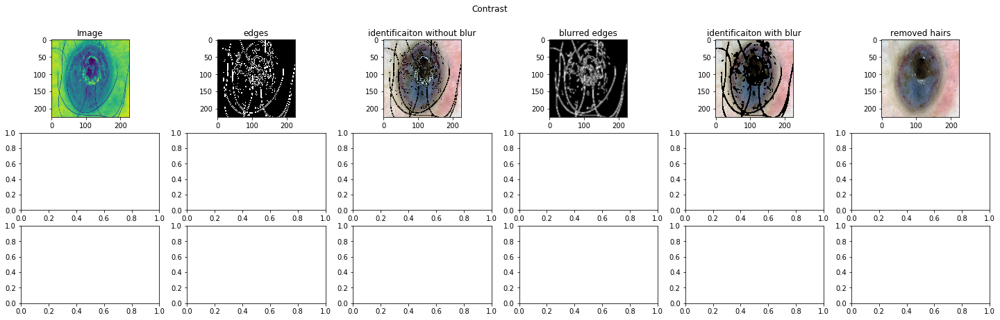

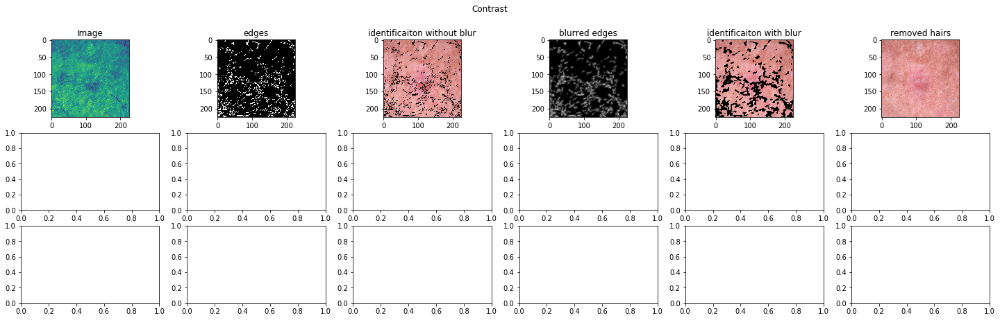

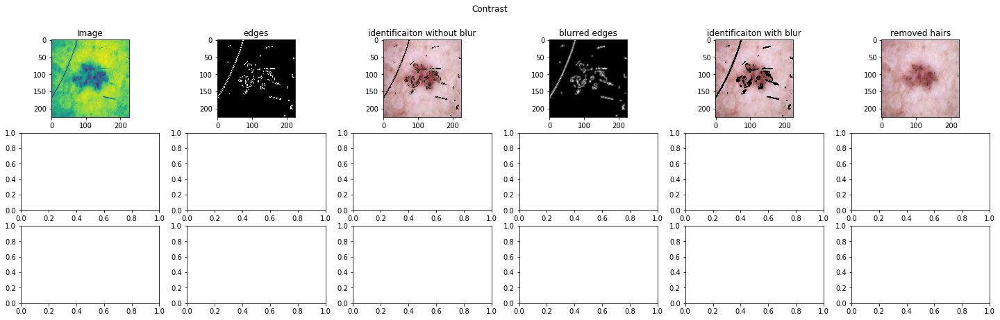

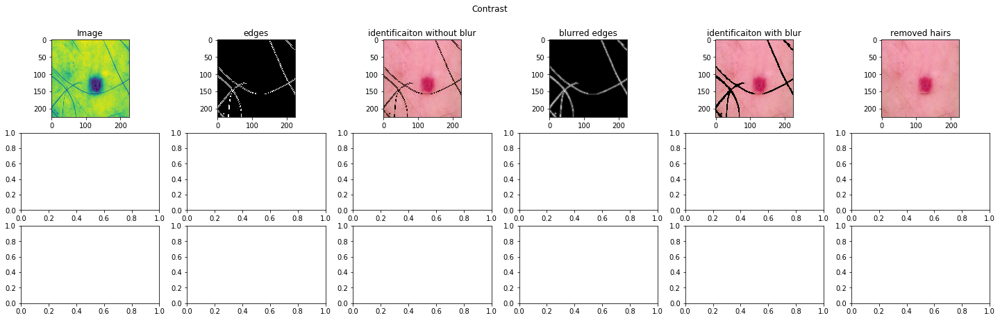

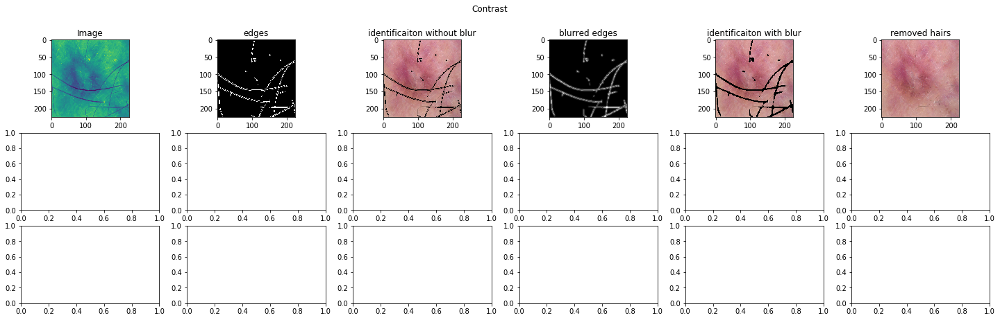

In [15]:
import time
numberOfStartedImages = 0

threads = []
def startNewThreads(numberOfStartedImages):
    temp = numberOfStartedImages
    for t in threads:
        if t.isAlive() == False:
            t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (temp, ))
            t.start()
            temp = temp + 1
#             if temp % 10 == 0:
            global numberOfProcessedImages
            print("numberOfStartedImages:", temp, "numberOdProcessedImages:", numberOfProcessedImages)
            if temp - numberOfStartedImages > 2:
                return temp
    return temp


for i in range(2):
    t = threading.Thread(target = showContrastWithBluredEdgeDetection4, args = (i, ))
    threads.append(t)
    t.start()
    numberOfStartedImages = numberOfStartedImages + 1
    print("numberOfStartedImages:", numberOfStartedImages, "numberOdProcessedImages:", numberOfProcessedImages)
    time.sleep(1)

while numberOfStartedImages < 8:
    temp = numberOfStartedImages
    numberOfStartedImages = startNewThreads(numberOfStartedImages)
    if numberOfStartedImages == temp:
        time.sleep(5)
    else:
        time.sleep(30)
        
for t in threads:
    t.join()
    
print('\nDone')

In [21]:
def threadProgram(j):
    for k in range(j):
        time.sleep(1)

threads = []

for i in range(5):
    t = threading.Thread(target = threadProgram, args = (7, ))
    threads.append(t)
    t.start()
    time.sleep(1)

for t in threads:
#     print(t.isAlive(), t.is_alive())
    if t.isAlive() == True:
        print('1')
    if t.isAlive():
        print('2')
    if t.isAlive() == False:
        print('3')
    if t.isAlive() is False:
        print('4')
        
for t in threads:
    t.join()

for t in threads:
#     print(t.isAlive(), t.is_alive())
    if t.isAlive() == True:
        print('1')
    if t.isAlive():
        print('2')
    if t.isAlive() == False:
        print('3')
    if t.isAlive() is False:
        print('4')
        
print('\nDone')

1
2
1
2
1
2
1
2
1
2
3
4
3
4
3
4
3
4
3
4

Done
